# Unsupervised Learning: CHALLENGE
## Clustering Movies 

In [104]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

### Data

In [70]:
links = pd.read_csv('../Some Data/ml-latest-small/links.csv')
ratings = pd.read_csv('..\Some Data\ml-latest-small/ratings.csv')
movies = pd.read_csv('..\Some Data\ml-latest-small/movies.csv')
tags = pd.read_csv('..\Some Data\ml-latest-small/tags.csv')

In [71]:
links

,movieId,imdbId,tmdbId
0,1,114709,862.0
1,2,113497,8844.0
2,3,113228,15602.0
3,4,114885,31357.0
4,5,113041,11862.0
...,...,...,...
9737,193581,5476944,432131.0
9738,193583,5914996,445030.0
9739,193585,6397426,479308.0
9740,193587,8391976,483455.0


In [72]:
ratings

,userId,movieId,rating,timestamp
0,1,1,4.0,964982703
1,1,3,4.0,964981247
2,1,6,4.0,964982224
3,1,47,5.0,964983815
4,1,50,5.0,964982931
...,...,...,...,...
100831,610,166534,4.0,1493848402
100832,610,168248,5.0,1493850091
100833,610,168250,5.0,1494273047
100834,610,168252,5.0,1493846352


In [106]:
# Determine the ratio of movies with less than 20 individual ratings
ratings_per_movie = ratings.groupby(by='movieId')['rating'].count()
ratings_per_movie.loc[ratings_per_movie < 20].count()/ratings_per_movie.count()

0.8666186754422048

In [74]:
print(movies.title.nunique())
movies


9737


,movieId,title,genres
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy
1,2,Jumanji (1995),Adventure|Children|Fantasy
2,3,Grumpier Old Men (1995),Comedy|Romance
3,4,Waiting to Exhale (1995),Comedy|Drama|Romance
4,5,Father of the Bride Part II (1995),Comedy
...,...,...,...
9737,193581,Black Butler: Book of the Atlantic (2017),Action|Animation|Comedy|Fantasy
9738,193583,No Game No Life: Zero (2017),Animation|Comedy|Fantasy
9739,193585,Flint (2017),Drama
9740,193587,Bungo Stray Dogs: Dead Apple (2018),Action|Animation


In [75]:
# Separate the genres into dummy variables
movies_genres = movies.genres.str.get_dummies(sep='|')
# Rename the column with no listed genre
movies_genres.rename({'(no genres listed)': 'Unlisted'}, axis=1, inplace=True)
# Lowercase all genre columns
movies_genres.rename(lambda x: x.lower(), axis=1, inplace=True)
movies_genres

,unlisted,action,adventure,animation,children,comedy,crime,documentary,drama,fantasy,film-noir,horror,imax,musical,mystery,romance,sci-fi,thriller,war,western
0,0,0,1,1,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0
1,0,0,1,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
3,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,0,0
4,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9737,0,1,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0
9738,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0
9739,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
9740,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [76]:
# Add the encoded genres to the movies dataset
movies = pd.concat([movies, movies_genres], axis=1)
movies

,movieId,title,genres,unlisted,action,adventure,animation,children,comedy,crime,...,film-noir,horror,imax,musical,mystery,romance,sci-fi,thriller,war,western
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,0,0,1,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0
1,2,Jumanji (1995),Adventure|Children|Fantasy,0,0,1,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
2,3,Grumpier Old Men (1995),Comedy|Romance,0,0,0,0,0,1,0,...,0,0,0,0,0,1,0,0,0,0
3,4,Waiting to Exhale (1995),Comedy|Drama|Romance,0,0,0,0,0,1,0,...,0,0,0,0,0,1,0,0,0,0
4,5,Father of the Bride Part II (1995),Comedy,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9737,193581,Black Butler: Book of the Atlantic (2017),Action|Animation|Comedy|Fantasy,0,1,0,1,0,1,0,...,0,0,0,0,0,0,0,0,0,0
9738,193583,No Game No Life: Zero (2017),Animation|Comedy|Fantasy,0,0,0,1,0,1,0,...,0,0,0,0,0,0,0,0,0,0
9739,193585,Flint (2017),Drama,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9740,193587,Bungo Stray Dogs: Dead Apple (2018),Action|Animation,0,1,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [77]:
print(tags.tag.str.lower().nunique())
tags

1475


,userId,movieId,tag,timestamp
0,2,60756,funny,1445714994
1,2,60756,Highly quotable,1445714996
2,2,60756,will ferrell,1445714992
3,2,89774,Boxing story,1445715207
4,2,89774,MMA,1445715200
...,...,...,...,...
3678,606,7382,for katie,1171234019
3679,606,7936,austere,1173392334
3680,610,3265,gun fu,1493843984
3681,610,3265,heroic bloodshed,1493843978


In [78]:
ratings.userId.value_counts().sort_values()

442      20
320      20
207      20
576      20
194      20
       ... 
274    1346
448    1864
474    2108
599    2478
414    2698
Name: userId, Length: 610, dtype: int64

In [79]:
# Aggregate ratings, movies, and number of users who submitted ratings
rating_grouped = ratings.groupby(by='movieId')
avg_ratings = rating_grouped['rating'].mean()
user_counts = rating_grouped['userId'].count()
latest_rating = rating_grouped['timestamp'].max()

# Concat all the aggregated series into one dataset
grouped_ratings = pd.concat([avg_ratings, user_counts, latest_rating], axis=1)
grouped_ratings

,rating,userId,timestamp
movieId,,,
1,3.920930,215,1535709666
2,3.431818,110,1529901723
3,3.259615,52,1498505071
4,2.357143,7,1237760055
5,3.071429,49,1517441319
...,...,...,...
193581,4.000000,1,1537109082
193583,3.500000,1,1537109545
193585,3.500000,1,1537109805


In [80]:
# Merge rating info with genre data on movie_id
movie_ratings = movies.merge(grouped_ratings, on='movieId')
movie_ratings.drop(['genres'], axis=1, inplace=True)
movie_ratings

,movieId,title,unlisted,action,adventure,animation,children,comedy,crime,documentary,...,musical,mystery,romance,sci-fi,thriller,war,western,rating,userId,timestamp
0,1,Toy Story (1995),0,0,1,1,1,1,0,0,...,0,0,0,0,0,0,0,3.920930,215,1535709666
1,2,Jumanji (1995),0,0,1,0,1,0,0,0,...,0,0,0,0,0,0,0,3.431818,110,1529901723
2,3,Grumpier Old Men (1995),0,0,0,0,0,1,0,0,...,0,0,1,0,0,0,0,3.259615,52,1498505071
3,4,Waiting to Exhale (1995),0,0,0,0,0,1,0,0,...,0,0,1,0,0,0,0,2.357143,7,1237760055
4,5,Father of the Bride Part II (1995),0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,3.071429,49,1517441319
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9719,193581,Black Butler: Book of the Atlantic (2017),0,1,0,1,0,1,0,0,...,0,0,0,0,0,0,0,4.000000,1,1537109082
9720,193583,No Game No Life: Zero (2017),0,0,0,1,0,1,0,0,...,0,0,0,0,0,0,0,3.500000,1,1537109545
9721,193585,Flint (2017),0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,3.500000,1,1537109805
9722,193587,Bungo Stray Dogs: Dead Apple (2018),0,1,0,1,0,0,0,0,...,0,0,0,0,0,0,0,3.500000,1,1537110021


In [81]:
# Extract the release year from the title column
movie_ratings['releaseYear'] = movie_ratings.title.str.extract(r'\(([0-9][0-9][0-9][0-9])\)')
movie_ratings.head()

,movieId,title,unlisted,action,adventure,animation,children,comedy,crime,documentary,...,mystery,romance,sci-fi,thriller,war,western,rating,userId,timestamp,releaseYear
0,1,Toy Story (1995),0,0,1,1,1,1,0,0,...,0,0,0,0,0,0,3.920930,215,1535709666,1995
1,2,Jumanji (1995),0,0,1,0,1,0,0,0,...,0,0,0,0,0,0,3.431818,110,1529901723,1995
2,3,Grumpier Old Men (1995),0,0,0,0,0,1,0,0,...,0,1,0,0,0,0,3.259615,52,1498505071,1995
3,4,Waiting to Exhale (1995),0,0,0,0,0,1,0,0,...,0,1,0,0,0,0,2.357143,7,1237760055,1995
4,5,Father of the Bride Part II (1995),0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,3.071429,49,1517441319,1995


In [82]:
# Drop null variables
movie_ratings.dropna(axis=0, inplace=True)
movie_ratings.isna().sum().sum()

0

In [83]:
# Drop columns that won't be included in the feature set
X = movie_ratings.drop(['movieId', 'title', 'timestamp'], axis=1)
X.head()

,unlisted,action,adventure,animation,children,comedy,crime,documentary,drama,fantasy,...,musical,mystery,romance,sci-fi,thriller,war,western,rating,userId,releaseYear
0,0,0,1,1,1,1,0,0,0,1,...,0,0,0,0,0,0,0,3.920930,215,1995
1,0,0,1,0,1,0,0,0,0,1,...,0,0,0,0,0,0,0,3.431818,110,1995
2,0,0,0,0,0,1,0,0,0,0,...,0,0,1,0,0,0,0,3.259615,52,1995
3,0,0,0,0,0,1,0,0,1,0,...,0,0,1,0,0,0,0,2.357143,7,1995
4,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,3.071429,49,1995


In [84]:
# Standardize the features
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_std = scaler.fit_transform(X)

In [85]:
# Create plottable components 
import umap

umap_model = umap.UMAP(n_neighbors = 25, min_dist=.2, metric='euclidean')
umap_results = umap_model.fit_transform(X_std)

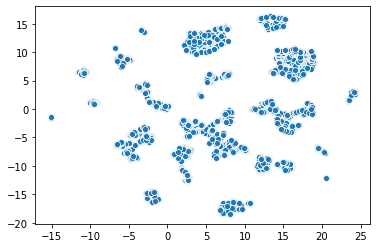

In [107]:
# Plot the umap components
sns.scatterplot(x=umap_results[:,0], y=umap_results[:,1])
plt.show()

### Clustering Models

In [110]:
# Initialize and test a KMEANS model

from sklearn.cluster import KMeans

str_class = 'abcdefghijklmnopqrstuvwxyz1234567890'

k_means = KMeans(n_clusters=3)

preds = k_means.fit_predict(X_std)

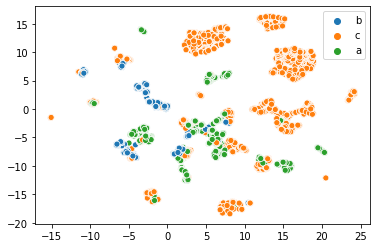

In [111]:
# Plot the scatterplot witht the predictions
sns.scatterplot(x=umap_results[:,0], y=umap_results[:,1], hue=pd.Series(preds).map({i: str_class[i] for i in pd.Series(preds).unique()}))
plt.show()

In [113]:
print(metrics.silhouette_score(X_std, preds))

0.14538499559464174


In [114]:

from sklearn.cluster import DBSCAN

eps = [.2, .5, .7, 1]
samps = [1, 2, 3, 4, 11]
ms = ['euclidean', 'correlation', 'cosine']

for e in eps:
    for s in samps:
        for m in ms:

            dbscan = DBSCAN(eps=e, min_samples=s, metric=m)
            preds = dbscan.fit_predict(X_std)

            preds_s = pd.Series(preds)
            num_clusts = preds_s.loc[preds_s != -1].nunique()
            print('epsilon:', e)
            print('minPts:', s)
            print('metric:', m)
            print('Number of clusters:', num_clusts)
            print('Silhouette score:', metrics.silhouette_score(X_std, preds, metric='euclidean'))

            print('-------------------------------------------------')

epsilon: 0.2
minPts: 1
metric: euclidean
Number of clusters: 6059
Silhouette score: 0.01342102390402299
-------------------------------------------------
epsilon: 0.2
minPts: 1
metric: correlation
Number of clusters: 33
Silhouette score: -0.010193220603981729
-------------------------------------------------
epsilon: 0.2
minPts: 1
metric: cosine
Number of clusters: 34
Silhouette score: -0.02528643675923211
-------------------------------------------------
epsilon: 0.2
minPts: 2
metric: euclidean
Number of clusters: 730
Silhouette score: -0.3253834268498517
-------------------------------------------------
epsilon: 0.2
minPts: 2
metric: correlation
Number of clusters: 15
Silhouette score: 0.14835778226363988
-------------------------------------------------
epsilon: 0.2
minPts: 2
metric: cosine
Number of clusters: 14
Silhouette score: 0.11470983686112536
-------------------------------------------------
epsilon: 0.2
minPts: 3
metric: euclidean
Number of clusters: 281
Silhouette score: -

ValueError: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)

In [ ]:
# Run an optimized dbscan model. Choose euclidean distance by use a min_samples number beyond the tested to see how it performs
dbscan = DBSCAN(eps=1, min_samples=20, metric='euclidean')
preds= dbscan.fit_predict(X_std)

preds_s = pd.Series(preds)

In [ ]:
sns.scatterplot(x=umap_results[:,0], y=umap_results[:,1], hue=preds_s.map({i: str_class[i] for i in preds_s}))
plt.show()

In [ ]:
metrics.silhouette_score(X_std, preds_s)

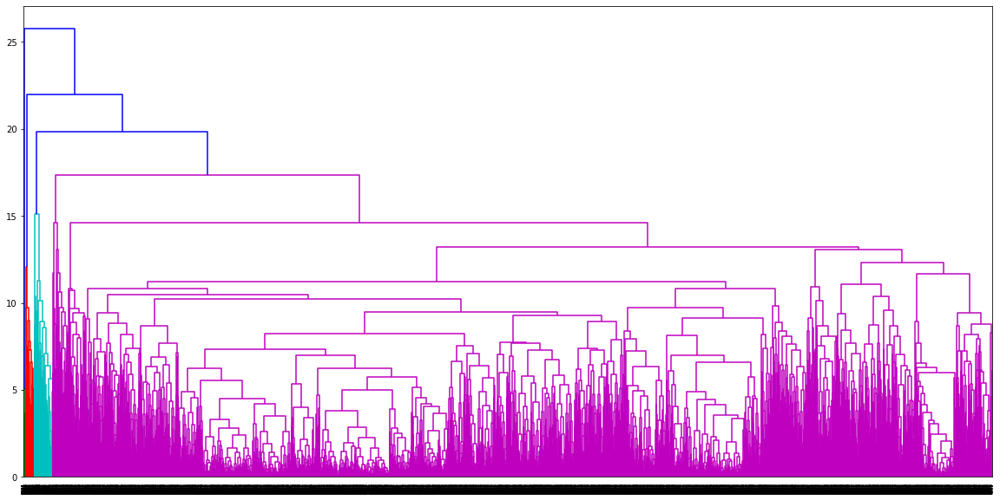

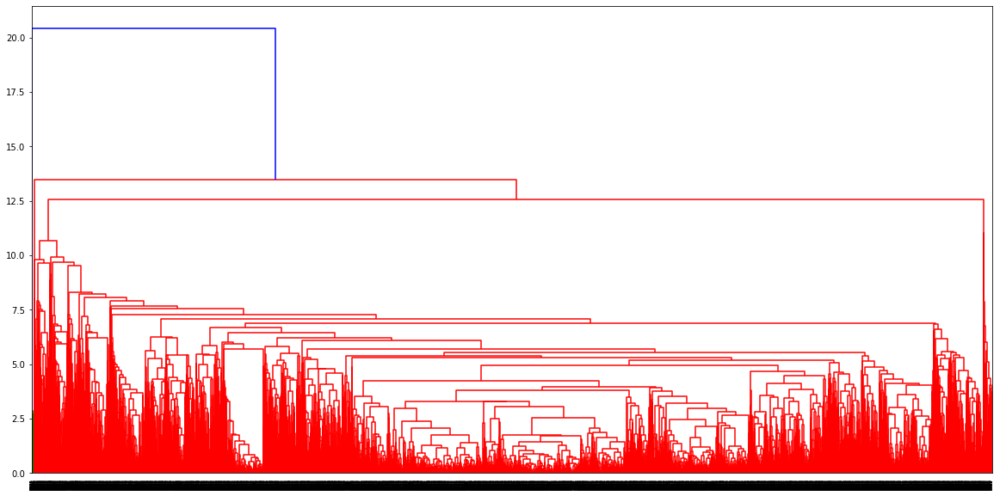

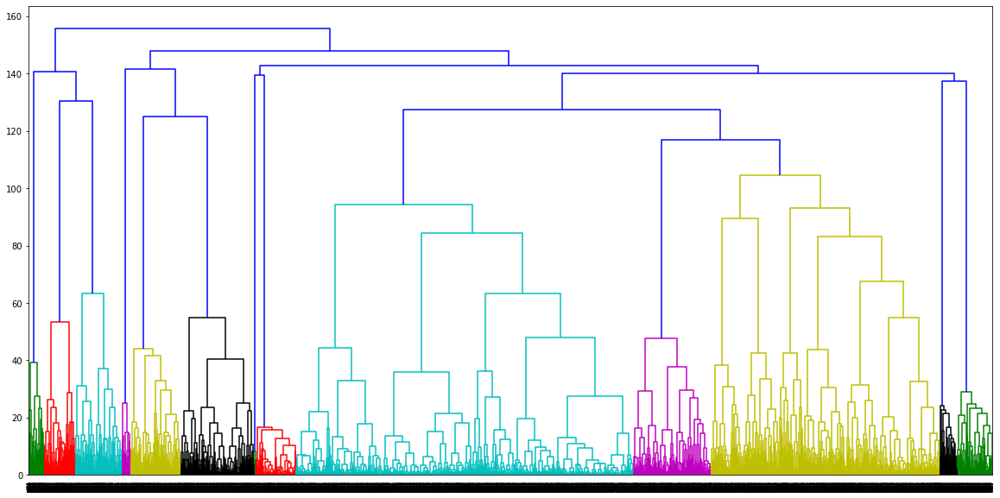

In [92]:
# Attempt hierarchical clustering. Start with dendrograms
from scipy.cluster.hierarchy import dendrogram, linkage
methods = ['complete', 'average', 'ward']

for method in methods:
    plt.figure(figsize=(20,10))
    dendrogram(linkage(X_std, method=method))
    plt.show()

In [93]:
# Using ward linkage, try several hierarchical clustering models, differing by number of clusters
from sklearn.cluster import AgglomerativeClustering
from sklearn import metrics

for nclust in [6, 9, 11, 13, 21, 30, 150]:
    agg_clust = AgglomerativeClustering(n_clusters=nclust,
                                        linkage='ward',
                                        affinity='euclidean')
    agg_preds = agg_clust.fit_predict(X_std)
    print('Hierarchical Clustering with \'ward\' linkage, {} clusters, and \'euclidean\' affinity'.format(nclust))
    print('Silhouette Score:', metrics.silhouette_score(X_std, agg_preds, metric='euclidean'))
    print('--------------------------------------------------------------------------------')

Hierarchical Clustering with 'ward' linkage, 6 clusters, and 'euclidean' affinity
Silhouette Score: 0.18916993534543705
--------------------------------------------------------------------------------
Hierarchical Clustering with 'ward' linkage, 9 clusters, and 'euclidean' affinity
Silhouette Score: 0.23029844603468344
--------------------------------------------------------------------------------
Hierarchical Clustering with 'ward' linkage, 11 clusters, and 'euclidean' affinity
Silhouette Score: 0.18384055299966284
--------------------------------------------------------------------------------
Hierarchical Clustering with 'ward' linkage, 13 clusters, and 'euclidean' affinity
Silhouette Score: 0.21638492762492129
--------------------------------------------------------------------------------
Hierarchical Clustering with 'ward' linkage, 21 clusters, and 'euclidean' affinity
Silhouette Score: 0.22237052059469978
-------------------------------------------------------------------------

We see that the optimal nclusters is somewhere near 9. Let's investigate near that number to find any alternatives. (The raising as we increase clusters is simply because the cluster sizes are shrinking, and with so few observations, the silhouette score will increase with increased clusters)

In [94]:
for nclust in [7, 8, 9, 10]:
    agg_clust = AgglomerativeClustering(n_clusters=nclust,
                                        linkage='ward',
                                        affinity='euclidean')
    agg_preds = agg_clust.fit_predict(X_std)
    print('Hierarchical Clustering with \'ward\' linkage, {} clusters, and \'euclidean\' affinity'.format(nclust))
    print('Silhouette Score:', metrics.silhouette_score(X_std, agg_preds, metric='euclidean'))
    print('--------------------------------------------------------------------------------')

Hierarchical Clustering with 'ward' linkage, 7 clusters, and 'euclidean' affinity
Silhouette Score: 0.2079627532999994
--------------------------------------------------------------------------------
Hierarchical Clustering with 'ward' linkage, 8 clusters, and 'euclidean' affinity
Silhouette Score: 0.2139205669485542
--------------------------------------------------------------------------------
Hierarchical Clustering with 'ward' linkage, 9 clusters, and 'euclidean' affinity
Silhouette Score: 0.23029844603468344
--------------------------------------------------------------------------------
Hierarchical Clustering with 'ward' linkage, 10 clusters, and 'euclidean' affinity
Silhouette Score: 0.24451128024687396
--------------------------------------------------------------------------------


In [95]:
# Run the optimal Agglomerative (hierarchical) clustering model
agg_clust_optimal = AgglomerativeClustering(n_clusters=10, linkage='ward', affinity='euclidean')
agg_preds_optimal = agg_clust_optimal.fit_predict(X_std)

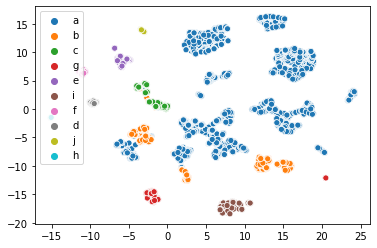

In [96]:
# Plot the components, colored by class
preds_s_optimal = pd.Series(agg_preds_optimal)
sns.scatterplot(x=umap_results[:,0], 
                y=umap_results[:,1], 
                hue=preds_s_optimal.map({i: str_class[i] for i in preds_s_optimal}))
plt.show()

In [97]:
# look at the number of observations in each cluster
preds_s_optimal.value_counts()

0    6491
1    1237
2     471
8     405
6     361
4     314
3     164
5     158
9      85
7      25
dtype: int64

We end up with some rather imbalanced clusters. This is not a model-breaking problem, so we will continue on by analyzing our clusters.

In [98]:
# Assign cluster to observations
clustered_movies = pd.DataFrame(X_std, columns=X.columns)
clustered_movies['cluster'] = preds_s_optimal
clustered_movies

,unlisted,action,adventure,animation,children,comedy,crime,documentary,drama,fantasy,...,mystery,romance,sci-fi,thriller,war,western,rating,userId,releaseYear,cluster
0,-0.050804,-0.481389,2.587456,3.862599,3.691206,1.259972,-0.374777,-0.217334,-0.900224,3.388511,...,-0.25041,-0.442647,-0.334648,-0.491102,-0.202079,-0.13228,0.758427,9.129683,0.018389,0
1,-0.050804,-0.481389,2.587456,-0.258893,3.691206,-0.793668,-0.374777,-0.217334,-0.900224,3.388511,...,-0.25041,-0.442647,-0.334648,-0.491102,-0.202079,-0.13228,0.195591,4.444778,0.018389,0
2,-0.050804,-0.481389,-0.386480,-0.258893,-0.270914,1.259972,-0.374777,-0.217334,-0.900224,-0.295115,...,-0.25041,2.259139,-0.334648,-0.491102,-0.202079,-0.13228,-0.002568,1.856925,0.018389,0
3,-0.050804,-0.481389,-0.386480,-0.258893,-0.270914,1.259972,-0.374777,-0.217334,1.110835,-0.295115,...,-0.25041,2.259139,-0.334648,-0.491102,-0.202079,-0.13228,-1.041070,-0.150891,0.018389,0
4,-0.050804,-0.481389,-0.386480,-0.258893,-0.270914,1.259972,-0.374777,-0.217334,-0.900224,-0.295115,...,-0.25041,-0.442647,-0.334648,-0.491102,-0.202079,-0.13228,-0.219120,1.723071,0.018389,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9706,-0.050804,2.077323,-0.386480,3.862599,-0.270914,1.259972,-0.374777,-0.217334,-0.900224,3.388511,...,-0.25041,-0.442647,-0.334648,-0.491102,-0.202079,-0.13228,0.849415,-0.418600,1.208145,2
9707,-0.050804,-0.481389,-0.386480,3.862599,-0.270914,1.259972,-0.374777,-0.217334,-0.900224,3.388511,...,-0.25041,-0.442647,-0.334648,-0.491102,-0.202079,-0.13228,0.274050,-0.418600,1.208145,2
9708,-0.050804,-0.481389,-0.386480,-0.258893,-0.270914,-0.793668,-0.374777,-0.217334,1.110835,-0.295115,...,-0.25041,-0.442647,-0.334648,-0.491102,-0.202079,-0.13228,0.274050,-0.418600,1.208145,0
9709,-0.050804,2.077323,-0.386480,3.862599,-0.270914,-0.793668,-0.374777,-0.217334,-0.900224,-0.295115,...,-0.25041,-0.442647,-0.334648,-0.491102,-0.202079,-0.13228,0.274050,-0.418600,1.262224,2


In [99]:
# Manually assign medoids to each cluster using kmeans with k = 1 to get the estimated center of each cluster
k_means_center = KMeans(n_clusters=1)

cluster_centers = pd.DataFrame(columns=X.columns)

for cluster in range(10):
    curr_X = clustered_movies.loc[clustered_movies['cluster'] == cluster].drop('cluster', axis=1)
    cluster_centers = cluster_centers.append(pd.Series(k_means_center.fit(curr_X).cluster_centers_[0], name=cluster, index=X.columns))

# Unstandardize the centers to accurately assess the differences between the clusters
cluster_centers_unscaled = pd.DataFrame(scaler.inverse_transform(cluster_centers), columns=cluster_centers.columns, index=cluster_centers.index)
cluster_centers_unscaled

,unlisted,action,adventure,animation,children,comedy,crime,documentary,drama,fantasy,...,musical,mystery,romance,sci-fi,thriller,war,western,rating,userId,releaseYear
0,0.0,0.195656,0.126945,0.002003,0.051456,0.463719,0.139116,0.000000,0.517178,7.749191e-02,...,0.000000,3.389308e-03,0.202126,0.087044,0.169003,0.000616,0.000000,3.224106,11.236019,1995.242181
1,0.0,0.134196,0.030719,0.012935,0.003234,0.171382,0.147130,0.000000,0.298302,3.718674e-02,...,0.000808,4.114794e-01,0.059014,0.189976,0.517381,0.000000,0.000000,3.038169,7.508488,1994.556993
2,0.0,0.265393,0.403397,1.000000,0.439490,0.441614,0.038217,0.000000,0.142251,2.547771e-01,...,0.000000,6.938894e-18,0.059448,0.188960,0.027601,0.000000,0.000000,3.525632,6.647558,2000.469214
3,0.0,0.237805,0.213415,0.018293,0.036585,0.237805,0.060976,0.006098,0.353659,3.658537e-02,...,0.060976,1.829268e-02,0.121951,0.042683,0.097561,0.060976,1.000000,3.387136,11.658537,1980.426829
4,0.0,0.015924,0.121019,0.200637,0.251592,0.509554,0.025478,0.038217,0.353503,1.464968e-01,...,1.000000,1.273885e-02,0.286624,0.019108,0.009554,0.006369,0.000000,3.283745,11.904459,1980.277070
5,0.0,0.588608,0.506329,0.215190,0.189873,0.170886,0.069620,0.050633,0.202532,2.974684e-01,...,0.050633,3.797468e-02,0.056962,0.392405,0.221519,0.025316,0.012658,3.311996,26.234177,2009.474684
6,0.0,0.332410,0.141274,0.019391,0.008310,0.155125,0.027701,0.033241,0.789474,1.939058e-02,...,0.000000,8.310249e-03,0.135734,0.030471,0.113573,1.000000,0.000000,3.580820,10.052632,1986.789474
7,1.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.387779e-17,...,0.000000,6.938894e-18,0.000000,0.000000,0.000000,0.000000,0.000000,3.204762,1.480000,2004.040000
8,0.0,0.009877,0.009877,0.002469,0.002469,0.096296,0.009877,1.000000,0.046914,4.938272e-03,...,0.000000,4.938272e-03,0.004938,0.000000,0.004938,0.000000,0.000000,3.789309,2.802469,2002.622222
9,0.0,0.058824,0.023529,0.023529,0.000000,0.023529,0.588235,0.000000,0.576471,1.176471e-02,...,0.000000,2.823529e-01,0.094118,0.035294,0.470588,0.000000,0.011765,3.670471,10.235294,1965.294118


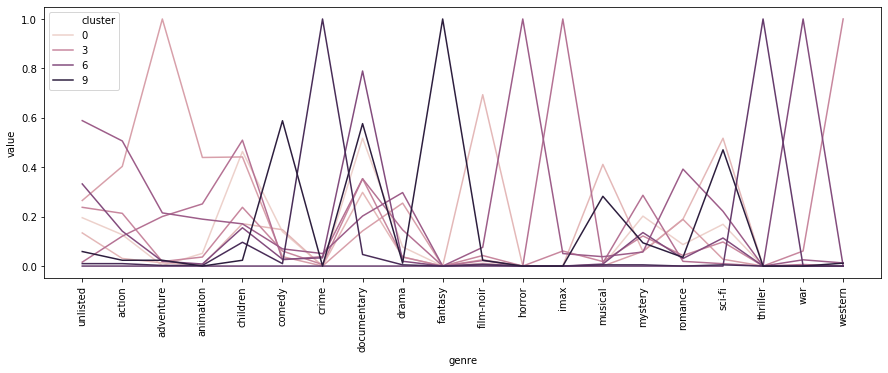

In [100]:
# Attempt to visually see the difference in genres between clusters
cat_cols = cluster_centers_unscaled.columns.drop(['rating', 'userId', 'releaseYear'])
centers = cluster_centers_unscaled[cat_cols]
centers['cluster'] = centers.index
plot_cent = centers.melt(id_vars=['cluster'], var_name='genre')
plt.figure(figsize=(15,5))
graph = sns.lineplot(x='genre', y='value', data=plot_cent, hue='cluster')
graph.set_xticklabels(labels=centers.columns,rotation=90)
plt.show()

In [101]:
# Find out which observation has the highest and lowest values for each column and assign those columns to that cluster. 

dominances = {key: {'highest': [], 'lowest': []} for key in clustered_movies['cluster'].unique()}
for col in cluster_centers_unscaled.columns:
    clust_id = cluster_centers_unscaled[col].sort_values(ascending=False).index[0]
    dominances[clust_id]['highest'].append(col)
    clust_id = cluster_centers_unscaled[col].sort_values(ascending=True).index[0]
    dominances[clust_id]['lowest'].append(col)

# Print the clusters, number of observations in each, and the assigned highest value columns and lowest value columns to the clusters
for key in sorted(dominances):
    print(key, clustered_movies['cluster'].value_counts()[key], 'observations')
    print('  highest', dominances[key]['highest'])
    print('  lowest ', dominances[key]['lowest'])

0 6491 observations
  highest []
  lowest  ['unlisted', 'documentary', 'film-noir', 'imax', 'musical', 'western']
1 1237 observations
  highest ['horror', 'mystery', 'thriller']
  lowest  ['war', 'rating']
2 471 observations
  highest ['animation', 'children']
  lowest  ['mystery']
3 164 observations
  highest ['western']
  lowest  []
4 314 observations
  highest ['comedy', 'musical', 'romance']
  lowest  []
5 158 observations
  highest ['action', 'adventure', 'fantasy', 'imax', 'sci-fi', 'userId', 'releaseYear']
  lowest  []
6 361 observations
  highest ['drama', 'war']
  lowest  []
7 25 observations
  highest ['unlisted']
  lowest  ['action', 'adventure', 'animation', 'children', 'comedy', 'crime', 'drama', 'fantasy', 'horror', 'romance', 'sci-fi', 'thriller', 'userId']
8 405 observations
  highest ['documentary', 'rating']
  lowest  []
9 85 observations
  highest ['crime', 'film-noir']
  lowest  ['releaseYear']


In [102]:
# Name the clusters
print('0: Average Movies')
print('1: Spooky Movies')
print('2: Kids Movies')
print('3: Western Movies')
print('4: RomCom Movies')
print('5: New/Blockbuster Movies (Most rated)')
print('6: War Movies')
print('7: Unlisted Genre Movies')
print('8: Documentary Movies (Highest rated)')
print('9: Old Crime Movies')

0: Average Movies
1: Spooky Movies
2: Kids Movies
3: Western Movies
4: RomCom Movies
5: New/Blockbuster Movies (Most rated)
6: War Movies
7: Unlisted Genre Movies
8: Documentary Movies (Highest rated)
9: Old Crime Movies


In [103]:
2\98/":u"

SyntaxError: unexpected character after line continuation character (<ipython-input-103-b7727a578f0c>, line 1)